# **Library**

In [45]:
import pandas as pd
import numpy as np
import nltk
import re
import string
import nltk
import torch
import matplotlib.pyplot as plt
import seaborn as sns
from nltk.tokenize import word_tokenize, sent_tokenize
from nltk.corpus import stopwords
from nltk.stem import PorterStemmer, WordNetLemmatizer
from gensim.models import Word2Vec
from sklearn.model_selection import train_test_split
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.ensemble import RandomForestClassifier
from sklearn.tree import DecisionTreeClassifier
from xgboost import XGBClassifier
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix, roc_curve, auc
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, LSTM, GRU, Embedding, SpatialDropout1D, Dropout, Bidirectional
from transformers import BertTokenizer, TFBertForSequenceClassification, BertModel, XLMRobertaTokenizer, XLMRobertaModel
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import RandomizedSearchCV
from scipy.stats import randint
import keras
from kerastuner.tuners import RandomSearch
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import ReduceLROnPlateau
from sklearn.metrics import classification_report, confusion_matrix, roc_auc_score, accuracy_score, precision_score, recall_score, f1_score

# **Data Preparation**

In [46]:
df = pd.read_csv('train.csv')

In [47]:
df.head(10)

,id,premise,hypothesis,lang_abv,language,label
0,5130fd2cb5,and these comments were considered in formulat...,The rules developed in the interim were put to...,en,English,0
1,5b72532a0b,These are issues that we wrestle with in pract...,Practice groups are not permitted to work on t...,en,English,2
2,3931fbe82a,Des petites choses comme celles-là font une di...,J'essayais d'accomplir quelque chose.,fr,French,0
3,5622f0c60b,you know they can't really defend themselves l...,They can't defend themselves because of their ...,en,English,0
4,86aaa48b45,ในการเล่นบทบาทสมมุติก็เช่นกัน โอกาสที่จะได้แสด...,เด็กสามารถเห็นได้ว่าชาติพันธุ์แตกต่างกันอย่างไร,th,Thai,1
5,ed7d6a1e62,"Bir çiftlikte birisinin, ağıla kapatılmış bu ö...",Çiftlikte insanlar farklı terimler kullanırlar.,tr,Turkish,0
6,5a0f4908a0,ریاست ہائے متحدہ امریکہ واپس آنے پر، ہج ایف بی...,ہیگ کی تفتیش ایف بی آئی اہلکاروں کی طرف سے کی...,ur,Urdu,0
7,fdcd1bd867,From Cockpit Country to St. Ann's Bay,From St. Ann's Bay to Cockpit Country.,en,English,2
8,7cfb3d272c,"Look, it's your skin, but you're going to be i...",The boss will fire you if he sees you slacking...,en,English,1
9,8c10229663,Через каждые сто градусов пятна краски меняют ...,Краска изменяется в соответствии с цветом.,ru,Russian,0


In [48]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 12120 entries, 0 to 12119
Data columns (total 6 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   id          12120 non-null  object
 1   premise     12120 non-null  object
 2   hypothesis  12120 non-null  object
 3   lang_abv    12120 non-null  object
 4   language    12120 non-null  object
 5   label       12120 non-null  int64 
dtypes: int64(1), object(5)
memory usage: 568.3+ KB


In [49]:
df.describe()

,label
count,12120.000000
mean,0.990759
std,0.824523
min,0.000000
25%,0.000000
50%,1.000000
75%,2.000000
max,2.000000


In [50]:
df.isnull().sum()

id            0
premise       0
hypothesis    0
lang_abv      0
language      0
label         0
dtype: int64

In [51]:
df.nunique()

id            12120
premise        8209
hypothesis    12119
lang_abv         15
language         15
label             3
dtype: int64

In [52]:
df.lang_abv.unique()

array(['en', 'fr', 'th', 'tr', 'ur', 'ru', 'bg', 'de', 'ar', 'zh', 'hi',
       'sw', 'vi', 'es', 'el'], dtype=object)

In [53]:
df.language.unique()

array(['English', 'French', 'Thai', 'Turkish', 'Urdu', 'Russian',
       'Bulgarian', 'German', 'Arabic', 'Chinese', 'Hindi', 'Swahili',
       'Vietnamese', 'Spanish', 'Greek'], dtype=object)

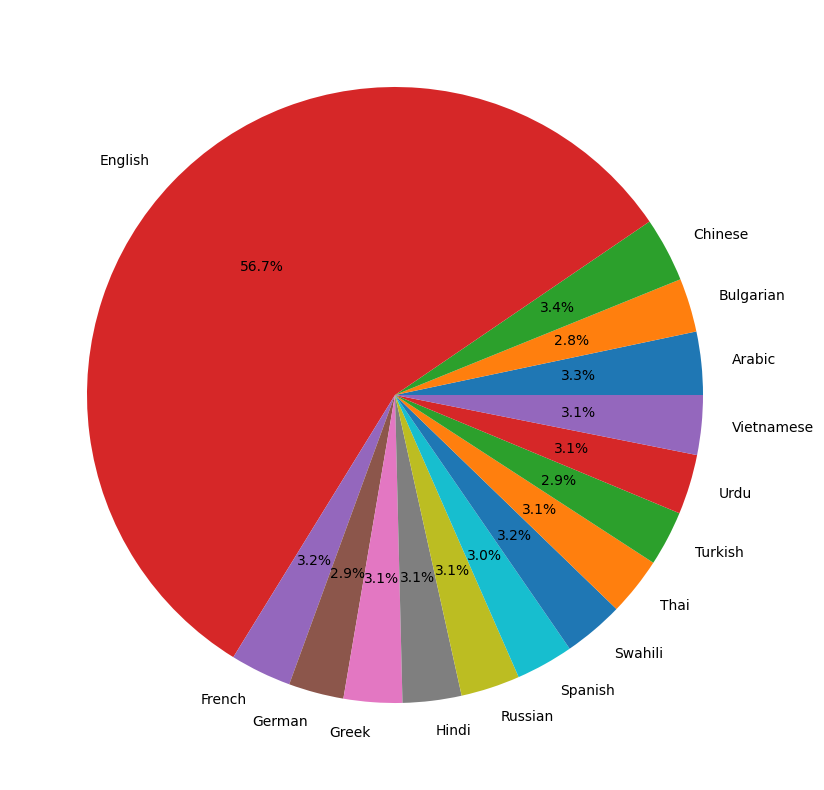

In [54]:
labels, frequencies = np.unique(df['language'], return_counts = True)

plt.figure(figsize = (10,10))
plt.pie(frequencies,labels = labels, autopct = '%1.1f%%')
plt.show()

C:\Users\kazbe\AppData\Local\Temp\ipykernel_18744\2388192808.py:2: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(x=df['label'], palette='coolwarm')


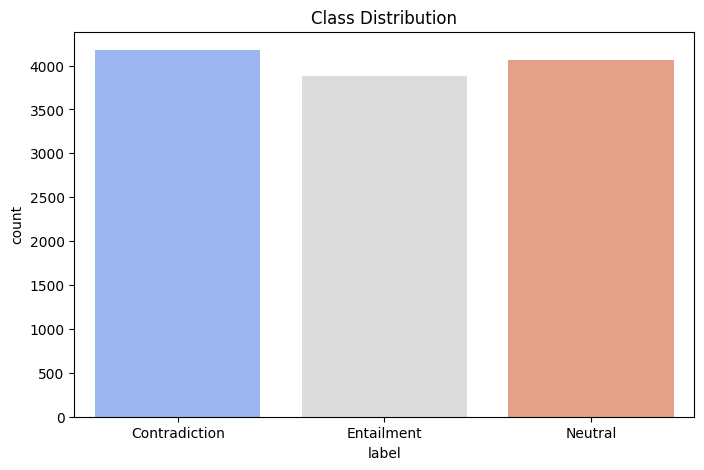

In [55]:
plt.figure(figsize=(8, 5))
sns.countplot(x=df['label'], palette='coolwarm')
plt.title("Class Distribution")
plt.xticks(ticks=[0, 1, 2], labels=["Contradiction", "Entailment", "Neutral"])
plt.show()

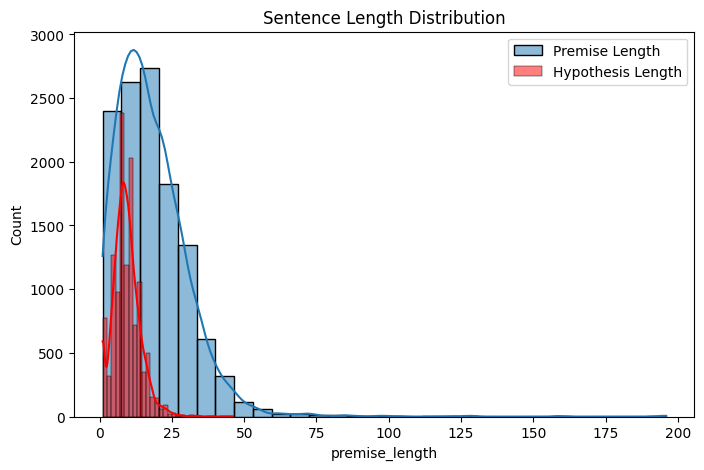

In [56]:
# Sentence Length Analysis
df['premise_length'] = df['premise'].apply(lambda x: len(str(x).split()))
df['hypothesis_length'] = df['hypothesis'].apply(lambda x: len(str(x).split()))
plt.figure(figsize=(8, 5))
sns.histplot(df['premise_length'], bins=30, kde=True, label='Premise Length')
sns.histplot(df['hypothesis_length'], bins=30, kde=True, label='Hypothesis Length', color='red')
plt.legend()
plt.title("Sentence Length Distribution")
plt.show()

# **Data Preprocessing**

In [57]:
# Define the languages to keep
languages_to_keep = {'English', 'French', 'Turkish', 'Russian', 'German', 'Arabic', 'Chinese', 'Spanish', 'Greek'}

# Filter the dataset
df= df[df['language'].isin(languages_to_keep)]

# Save the filtered dataset
filtered_file_path = "train_filtered.csv"
df.to_csv(filtered_file_path, index=False)

# Return the path of the filtered file
filtered_file_path


'train_filtered.csv'

In [58]:
nltk.download('punkt_tab')
nltk.download('wordnet')

[nltk_data] Downloading package punkt_tab to
[nltk_data]     C:\Users\kazbe\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt_tab is already up-to-date!
[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\kazbe\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


True

In [59]:
def preprocess_text(text, language):
    # Download required NLTK resources if not already downloaded
    nltk.download('punkt_tab')
    # Download stopwords only if they are not already downloaded for the specific language
    try:
        stopwords.words(language)
    except LookupError:
        nltk.download('stopwords')

    # Remove special characters and punctuation using regex
    text = re.sub(r'[^\w\s]', '', text)

    # Tokenize the text
    tokens = word_tokenize(text)

    # Remove stop words
    stop_words = set(stopwords.words(language))
    tokens = [token for token in tokens if token not in stop_words]

    return tokens

# Example usage:
languages = ['english', 'french', 'turkish', 'russian', 'german', 'arabic', 'chinese', 'spanish', 'greek']

for language in languages:
    # Apply preprocessing to 'premise' column
    df['premise_processed'] = df['premise'].apply(lambda x: preprocess_text(x, language))

    # Apply preprocessing to 'hypothesis' column
    df['hypothesis_processed'] = df['hypothesis'].apply(lambda x: preprocess_text(x, language))

[nltk_data] Downloading package punkt_tab to
[nltk_data]     C:\Users\kazbe\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt_tab is already up-to-date!
[nltk_data] Downloading package punkt_tab to
[nltk_data]     C:\Users\kazbe\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt_tab is already up-to-date!
[nltk_data] Downloading package punkt_tab to
[nltk_data]     C:\Users\kazbe\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt_tab is already up-to-date!
[nltk_data] Downloading package punkt_tab to
[nltk_data]     C:\Users\kazbe\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt_tab is already up-to-date!
[nltk_data] Downloading package punkt_tab to
[nltk_data]     C:\Users\kazbe\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt_tab is already up-to-date!
[nltk_data] Downloading package punkt_tab to
[nltk_data]     C:\Users\kazbe\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt_tab is already up-to-date!
[nltk_data] Downloading package punkt_ta

In [60]:
df.head(20)

,id,premise,hypothesis,lang_abv,language,label,premise_length,hypothesis_length,premise_processed,hypothesis_processed
0,5130fd2cb5,and these comments were considered in formulat...,The rules developed in the interim were put to...,en,English,0,10,14,"[and, these, comments, were, considered, in, f...","[The, rules, developed, in, the, interim, were..."
1,5b72532a0b,These are issues that we wrestle with in pract...,Practice groups are not permitted to work on t...,en,English,2,15,10,"[These, are, issues, that, we, wrestle, with, ...","[Practice, groups, are, not, permitted, to, wo..."
2,3931fbe82a,Des petites choses comme celles-là font une di...,J'essayais d'accomplir quelque chose.,fr,French,0,15,4,"[Des, petites, choses, comme, celleslà, font, ...","[Jessayais, daccomplir, quelque, chose]"
3,5622f0c60b,you know they can't really defend themselves l...,They can't defend themselves because of their ...,en,English,0,17,8,"[you, know, they, cant, really, defend, themse...","[They, cant, defend, themselves, because, of, ..."
5,ed7d6a1e62,"Bir çiftlikte birisinin, ağıla kapatılmış bu ö...",Çiftlikte insanlar farklı terimler kullanırlar.,tr,Turkish,0,18,5,"[Bir, çiftlikte, birisinin, ağıla, kapatılmış,...","[Çiftlikte, insanlar, farklı, terimler, kullan..."
7,fdcd1bd867,From Cockpit Country to St. Ann's Bay,From St. Ann's Bay to Cockpit Country.,en,English,2,7,7,"[From, Cockpit, Country, to, St, Anns, Bay]","[From, St, Anns, Bay, to, Cockpit, Country]"
8,7cfb3d272c,"Look, it's your skin, but you're going to be i...",The boss will fire you if he sees you slacking...,en,English,1,16,11,"[Look, its, your, skin, but, youre, going, to,...","[The, boss, will, fire, you, if, he, sees, you..."
9,8c10229663,Через каждые сто градусов пятна краски меняют ...,Краска изменяется в соответствии с цветом.,ru,Russian,0,18,6,"[Через, каждые, сто, градусов, пятна, краски, ...","[Краска, изменяется, в, соответствии, с, цветом]"
11,2bf4b86d4f,Es fallen zwanzig Prozent Zinsen an,Könnte das Interesse mehr als 20 sein?,de,German,1,6,7,"[Es, fallen, zwanzig, Prozent, Zinsen, an]","[Könnte, das, Interesse, mehr, als, 20, sein]"
12,91b03f6bf4,إذا أمكن ، تعرّف على المؤامرة مسبقًا.,حاول أن تفهم الحبكة في البداية، إذا كنت تستطيع.,ar,Arabic,0,7,9,"[إذا, أمكن, تعرف, على, المؤامرة, مسبقا]","[حاول, أن, تفهم, الحبكة, في, البداية, إذا, كنت..."


In [61]:
# 1. Stemming or Lemmatization
stemmer = PorterStemmer()
lemmatizer = WordNetLemmatizer()

def process_tokens(tokens, method="lemmatization"):
    if method == "stemming":
        return [stemmer.stem(word) for word in tokens]
    elif method == "lemmatization":
        return [lemmatizer.lemmatize(word) for word in tokens]
    else:
        raise ValueError("Invalid method. Choose 'stemming' or 'lemmatization'.")

df['premise_processed'] = df['premise_processed'].apply(lambda x: process_tokens(x, method="lemmatization"))
df['hypothesis_processed'] = df['hypothesis_processed'].apply(lambda x: process_tokens(x, method="lemmatization"))

# 2. Word2Vec Training
sentences = df['premise_processed'].tolist() + df['hypothesis_processed'].tolist()
word2vec_model = Word2Vec(sentences, vector_size=100, window=5, min_count=1, workers=4)

# 3. Convert Text to Word2Vec Embeddings
def get_sentence_embedding(tokens, model):
    word_vectors = [model.wv[word] for word in tokens if word in model.wv]
    return np.mean(word_vectors, axis=0) if word_vectors else np.zeros(model.vector_size)

# Convert sentences to embeddings
df['premise_embeddings'] = df['premise_processed'].apply(lambda x: get_sentence_embedding(x, word2vec_model))
df['hypothesis_embeddings'] = df['hypothesis_processed'].apply(lambda x: get_sentence_embedding(x, word2vec_model))

# 4. Final Numeric Representations
X = np.hstack([np.vstack(df['premise_embeddings']), np.vstack(df['hypothesis_embeddings'])])

# Print Results
print("Feature Matrix Shape:", X.shape)
print(X[:2])  # Print first two examples


Feature Matrix Shape: (9888, 200)
[[-2.95193255e-01  9.92770493e-01 -2.94235051e-01  7.87097335e-01
   2.40701362e-01 -1.50361383e+00  4.48597610e-01  2.03526068e+00
  -1.03440917e+00 -8.92846704e-01 -9.53159556e-02 -1.22095084e+00
  -3.11118394e-01  1.01006937e+00  5.31760573e-01 -5.23264110e-01
   4.12416995e-01  3.83688733e-02 -4.71577108e-01 -1.77399635e+00
   3.08420658e-01  2.70082742e-01  8.31181407e-01  3.87044181e-03
   3.26698840e-01  8.04224238e-03 -7.93574691e-01 -2.36192748e-01
  -7.29790330e-01 -2.06646994e-01  7.63884068e-01 -4.53434795e-01
   5.08843422e-01 -1.54229140e+00 -5.17856479e-01  7.52749443e-01
   3.42413098e-01 -2.56497145e-01 -1.85078368e-01 -1.00165820e+00
   3.40740196e-02 -1.10546279e+00 -2.47445345e-01  5.44121981e-01
   8.72120738e-01 -4.05935943e-01 -1.17203796e+00 -7.02176318e-02
   7.33205955e-03  2.62709707e-01  1.88185461e-02 -4.73350048e-01
  -3.51039112e-01  1.98599137e-02 -6.06170595e-01  3.65951598e-01
   9.92931545e-01 -3.55980247e-01 -6.84870

In [62]:
df.head(20)

,id,premise,hypothesis,lang_abv,language,label,premise_length,hypothesis_length,premise_processed,hypothesis_processed,premise_embeddings,hypothesis_embeddings
0,5130fd2cb5,and these comments were considered in formulat...,The rules developed in the interim were put to...,en,English,0,10,14,"[and, these, comment, were, considered, in, fo...","[The, rule, developed, in, the, interim, were,...","[-0.29519325, 0.9927705, -0.29423505, 0.787097...","[-0.283178, 1.0090796, -0.28163534, 0.8057173,..."
1,5b72532a0b,These are issues that we wrestle with in pract...,Practice groups are not permitted to work on t...,en,English,2,15,10,"[These, are, issue, that, we, wrestle, with, i...","[Practice, group, are, not, permitted, to, wor...","[-0.36519888, 1.0426203, -0.31608945, 0.892122...","[-0.37455988, 1.1082766, -0.3473789, 0.8479341..."
2,3931fbe82a,Des petites choses comme celles-là font une di...,J'essayais d'accomplir quelque chose.,fr,French,0,15,4,"[Des, petite, choses, comme, celleslà, font, u...","[Jessayais, daccomplir, quelque, chose]","[-0.050710518, 0.22210057, 0.23325375, 0.58406...","[-0.018383078, 0.045230404, 0.0128545, 0.08268..."
3,5622f0c60b,you know they can't really defend themselves l...,They can't defend themselves because of their ...,en,English,0,17,8,"[you, know, they, cant, really, defend, themse...","[They, cant, defend, themselves, because, of, ...","[-0.65127957, 1.0473447, -0.5177884, 1.1226759...","[-0.30995712, 0.86819756, -0.27704063, 0.74292..."
5,ed7d6a1e62,"Bir çiftlikte birisinin, ağıla kapatılmış bu ö...",Çiftlikte insanlar farklı terimler kullanırlar.,tr,Turkish,0,18,5,"[Bir, çiftlikte, birisinin, ağıla, kapatılmış,...","[Çiftlikte, insanlar, farklı, terimler, kullan...","[-0.025298696, 0.079190925, 0.019003876, 0.134...","[-0.008148797, 0.034080118, 0.012763238, 0.061..."
7,fdcd1bd867,From Cockpit Country to St. Ann's Bay,From St. Ann's Bay to Cockpit Country.,en,English,2,7,7,"[From, Cockpit, Country, to, St, Anns, Bay]","[From, St, Anns, Bay, to, Cockpit, Country]","[-0.16639434, 0.45097014, -0.11079762, 0.37555...","[-0.16639435, 0.4509701, -0.11079761, 0.375559..."
8,7cfb3d272c,"Look, it's your skin, but you're going to be i...",The boss will fire you if he sees you slacking...,en,English,1,16,11,"[Look, it, your, skin, but, youre, going, to, ...","[The, bos, will, fire, you, if, he, see, you, ...","[-0.58668935, 1.2315354, -0.47895178, 1.053741...","[-0.56564814, 1.1869961, -0.46228507, 1.035077..."
9,8c10229663,Через каждые сто градусов пятна краски меняют ...,Краска изменяется в соответствии с цветом.,ru,Russian,0,18,6,"[Через, каждые, сто, градусов, пятна, краски, ...","[Краска, изменяется, в, соответствии, с, цветом]","[-0.04145896, 0.14019081, 0.049153786, 0.27273...","[-0.080408, 0.2847272, 0.09606316, 0.5346606, ..."
11,2bf4b86d4f,Es fallen zwanzig Prozent Zinsen an,Könnte das Interesse mehr als 20 sein?,de,German,1,6,7,"[Es, fallen, zwanzig, Prozent, Zinsen, an]","[Könnte, da, Interesse, mehr, al, 20, sein]","[-0.0919143, 0.35080656, -0.059609592, 0.34776...","[-0.05474462, 0.24440019, 0.094864786, 0.46236..."
12,91b03f6bf4,إذا أمكن ، تعرّف على المؤامرة مسبقًا.,حاول أن تفهم الحبكة في البداية، إذا كنت تستطيع.,ar,Arabic,0,7,9,"[إذا, أمكن, تعرف, على, المؤامرة, مسبقا]","[حاول, أن, تفهم, الحبكة, في, البداية, إذا, كنت...","[-0.058223557, 0.20340113, 0.052217368, 0.3531...","[-0.07119892, 0.24980858, 0.088489495, 0.47379..."


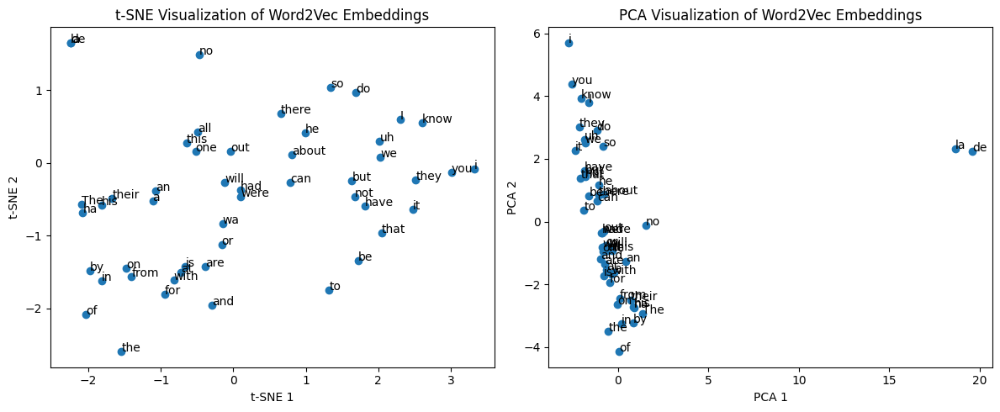

In [63]:
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt

# Get the word vectors for a few words
words = list(word2vec_model.wv.index_to_key)[:50]  # First 50 words
word_vectors = np.array([word2vec_model.wv[word] for word in words])

# Reduce dimensionality using t-SNE
tsne = TSNE(n_components=2, random_state=42)
word_vectors_tsne = tsne.fit_transform(word_vectors)

# Reduce dimensionality using PCA
pca = PCA(n_components=2, random_state=42)
word_vectors_pca = pca.fit_transform(word_vectors)

# Plot t-SNE
plt.figure(figsize=(12, 5))

plt.subplot(1, 2, 1)
plt.scatter(word_vectors_tsne[:, 0], word_vectors_tsne[:, 1])
for i, word in enumerate(words):
    plt.text(word_vectors_tsne[i, 0], word_vectors_tsne[i, 1], word)
plt.title('t-SNE Visualization of Word2Vec Embeddings')
plt.xlabel('t-SNE 1')
plt.ylabel('t-SNE 2')

# Plot PCA
plt.subplot(1, 2, 2)
plt.scatter(word_vectors_pca[:, 0], word_vectors_pca[:, 1])
for i, word in enumerate(words):
    plt.text(word_vectors_pca[i, 0], word_vectors_pca[i, 1], word)
plt.title('PCA Visualization of Word2Vec Embeddings')
plt.xlabel('PCA 1')
plt.ylabel('PCA 2')

plt.tight_layout()
plt.show()

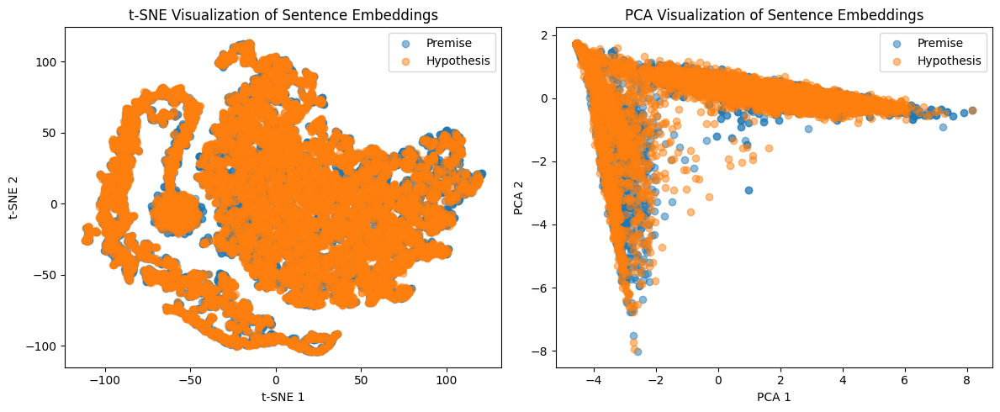

In [64]:
# Combine premise and hypothesis embeddings
sentence_embeddings = np.vstack(df['premise_embeddings'].tolist() + df['hypothesis_embeddings'].tolist())

# Reduce dimensionality using t-SNE
tsne = TSNE(n_components=2, random_state=42)
sentence_embeddings_tsne = tsne.fit_transform(sentence_embeddings)

# Reduce dimensionality using PCA
pca = PCA(n_components=2, random_state=42)
sentence_embeddings_pca = pca.fit_transform(sentence_embeddings)

# Plot t-SNE
plt.figure(figsize=(12, 5))

plt.subplot(1, 2, 1)
plt.scatter(sentence_embeddings_tsne[:len(df), 0], sentence_embeddings_tsne[:len(df), 1], label='Premise', alpha=0.5)
plt.scatter(sentence_embeddings_tsne[len(df):, 0], sentence_embeddings_tsne[len(df):, 1], label='Hypothesis', alpha=0.5)
plt.title('t-SNE Visualization of Sentence Embeddings')
plt.xlabel('t-SNE 1')
plt.ylabel('t-SNE 2')
plt.legend()

# Plot PCA
plt.subplot(1, 2, 2)
plt.scatter(sentence_embeddings_pca[:len(df), 0], sentence_embeddings_pca[:len(df), 1], label='Premise', alpha=0.5)
plt.scatter(sentence_embeddings_pca[len(df):, 0], sentence_embeddings_pca[len(df):, 1], label='Hypothesis', alpha=0.5)
plt.title('PCA Visualization of Sentence Embeddings')
plt.xlabel('PCA 1')
plt.ylabel('PCA 2')
plt.legend()

plt.tight_layout()
plt.show()

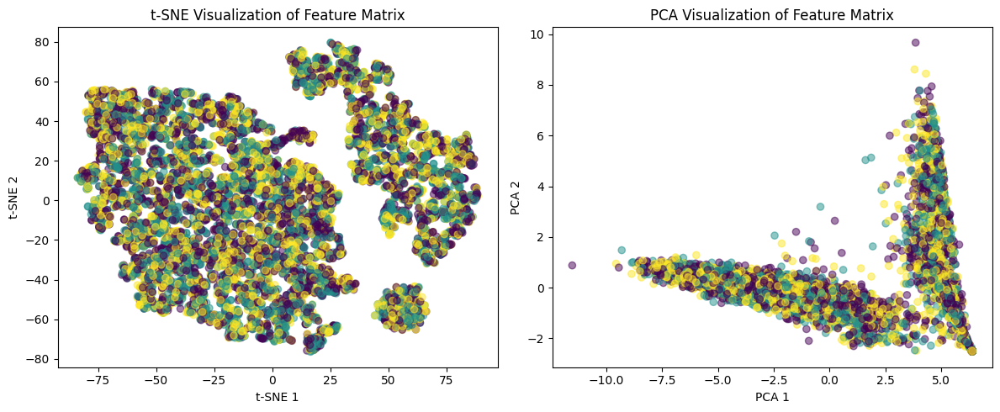

In [65]:
# Reduce dimensionality using t-SNE
tsne = TSNE(n_components=2, random_state=42)
X_tsne = tsne.fit_transform(X)

# Reduce dimensionality using PCA
pca = PCA(n_components=2, random_state=42)
X_pca = pca.fit_transform(X)

# Plot t-SNE
plt.figure(figsize=(12, 5))

plt.subplot(1, 2, 1)
plt.scatter(X_tsne[:, 0], X_tsne[:, 1], c=df['label'], cmap='viridis', alpha=0.5)
plt.title('t-SNE Visualization of Feature Matrix')
plt.xlabel('t-SNE 1')
plt.ylabel('t-SNE 2')

# Plot PCA
plt.subplot(1, 2, 2)
plt.scatter(X_pca[:, 0], X_pca[:, 1], c=df['label'], cmap='viridis', alpha=0.5)
plt.title('PCA Visualization of Feature Matrix')
plt.xlabel('PCA 1')
plt.ylabel('PCA 2')

plt.tight_layout()
plt.show()

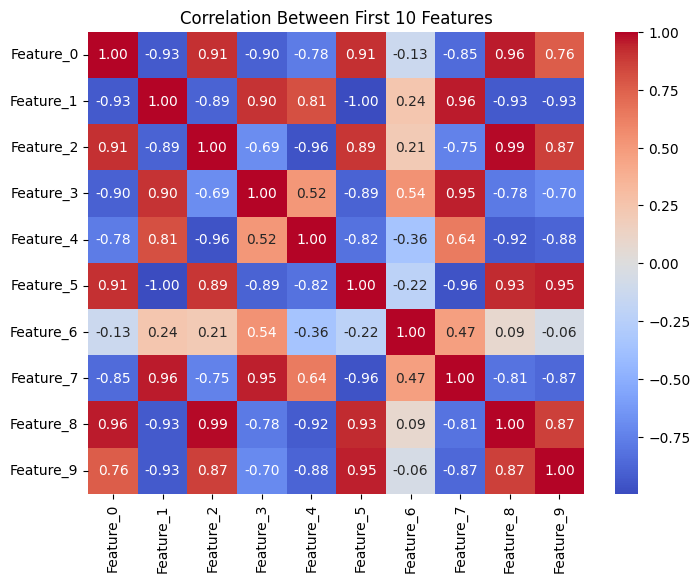

In [66]:
import pandas as pd
import seaborn as sns

# Create a DataFrame for the first 10 features
feature_df = pd.DataFrame(X[:, :10], columns=[f'Feature_{i}' for i in range(10)])

# Compute correlation matrix
corr_matrix = feature_df.corr()

# Plot heatmap
plt.figure(figsize=(8, 6))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', fmt='.2f')
plt.title('Correlation Between First 10 Features')
plt.show()

# **Train-Test Spliting**

In [67]:
# Keep only required columns
df = df[['label', 'premise_embeddings', 'hypothesis_embeddings']]

# Split the data: 80% train, 20% temp (which will be split into val/test)
train_data, temp_data = train_test_split(df, test_size=0.2, random_state=42, stratify=df['label'])

# Split temp data into validation (10%) and test (10%)
val_data, test_data = train_test_split(temp_data, test_size=0.5, random_state=42, stratify=temp_data['label'])

# Print dataset sizes
print("Training Set:", train_data.shape)
print("Validation Set:", val_data.shape)
print("Test Set:", test_data.shape)

# Extract feature matrices and labels
X_train = np.vstack(train_data.apply(lambda row: np.concatenate((row['premise_embeddings'], row['hypothesis_embeddings'])), axis=1))
y_train = train_data['label'].values

X_val = np.vstack(val_data.apply(lambda row: np.concatenate((row['premise_embeddings'], row['hypothesis_embeddings'])), axis=1))
y_val = val_data['label'].values

X_test = np.vstack(test_data.apply(lambda row: np.concatenate((row['premise_embeddings'], row['hypothesis_embeddings'])), axis=1))
y_test = test_data['label'].values

print("Feature matrix (train) shape:", X_train.shape)
print("Feature matrix (val) shape:", X_val.shape)
print("Feature matrix (test) shape:", X_test.shape)


Training Set: (7910, 3)
Validation Set: (989, 3)
Test Set: (989, 3)
Feature matrix (train) shape: (7910, 200)
Feature matrix (val) shape: (989, 200)
Feature matrix (test) shape: (989, 200)


In [68]:
df.head(20)

,label,premise_embeddings,hypothesis_embeddings
0,0,"[-0.29519325, 0.9927705, -0.29423505, 0.787097...","[-0.283178, 1.0090796, -0.28163534, 0.8057173,..."
1,2,"[-0.36519888, 1.0426203, -0.31608945, 0.892122...","[-0.37455988, 1.1082766, -0.3473789, 0.8479341..."
2,0,"[-0.050710518, 0.22210057, 0.23325375, 0.58406...","[-0.018383078, 0.045230404, 0.0128545, 0.08268..."
3,0,"[-0.65127957, 1.0473447, -0.5177884, 1.1226759...","[-0.30995712, 0.86819756, -0.27704063, 0.74292..."
5,0,"[-0.025298696, 0.079190925, 0.019003876, 0.134...","[-0.008148797, 0.034080118, 0.012763238, 0.061..."
7,2,"[-0.16639434, 0.45097014, -0.11079762, 0.37555...","[-0.16639435, 0.4509701, -0.11079761, 0.375559..."
8,1,"[-0.58668935, 1.2315354, -0.47895178, 1.053741...","[-0.56564814, 1.1869961, -0.46228507, 1.035077..."
9,0,"[-0.04145896, 0.14019081, 0.049153786, 0.27273...","[-0.080408, 0.2847272, 0.09606316, 0.5346606, ..."
11,1,"[-0.0919143, 0.35080656, -0.059609592, 0.34776...","[-0.05474462, 0.24440019, 0.094864786, 0.46236..."
12,0,"[-0.058223557, 0.20340113, 0.052217368, 0.3531...","[-0.07119892, 0.24980858, 0.088489495, 0.47379..."


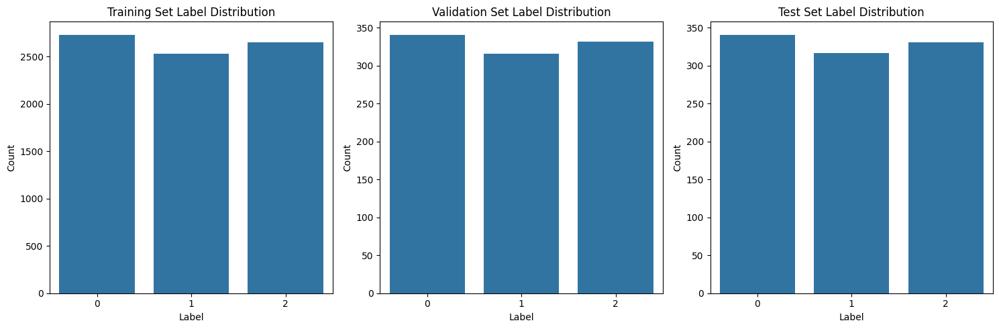

In [69]:
import matplotlib.pyplot as plt
import seaborn as sns

# Plot label distribution
plt.figure(figsize=(15, 5))

# Training set
plt.subplot(1, 3, 1)
sns.countplot(x=train_data['label'])
plt.title('Training Set Label Distribution')
plt.xlabel('Label')
plt.ylabel('Count')

# Validation set
plt.subplot(1, 3, 2)
sns.countplot(x=val_data['label'])
plt.title('Validation Set Label Distribution')
plt.xlabel('Label')
plt.ylabel('Count')

# Test set
plt.subplot(1, 3, 3)
sns.countplot(x=test_data['label'])
plt.title('Test Set Label Distribution')
plt.xlabel('Label')
plt.ylabel('Count')

plt.tight_layout()
plt.show()

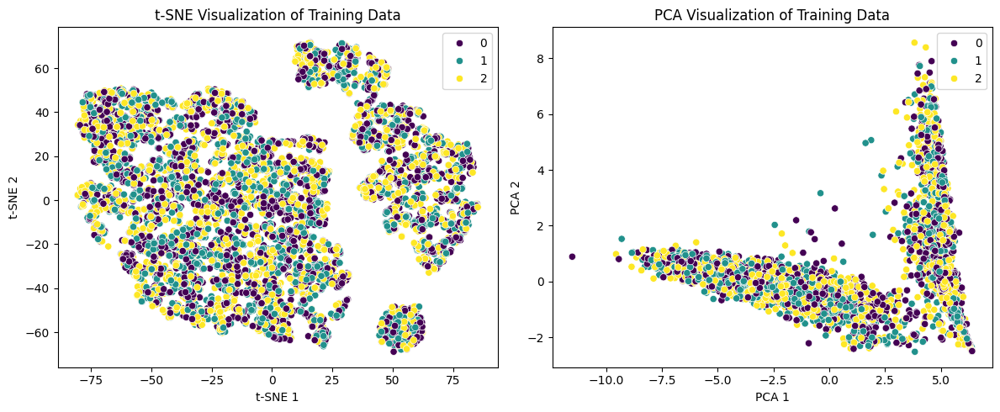

In [70]:
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA

# Reduce dimensionality using t-SNE
tsne = TSNE(n_components=2, random_state=42)
X_train_tsne = tsne.fit_transform(X_train)

# Reduce dimensionality using PCA
pca = PCA(n_components=2, random_state=42)
X_train_pca = pca.fit_transform(X_train)

# Plot t-SNE
plt.figure(figsize=(12, 5))

plt.subplot(1, 2, 1)
sns.scatterplot(x=X_train_tsne[:, 0], y=X_train_tsne[:, 1], hue=y_train, palette='viridis')
plt.title('t-SNE Visualization of Training Data')
plt.xlabel('t-SNE 1')
plt.ylabel('t-SNE 2')

# Plot PCA
plt.subplot(1, 2, 2)
sns.scatterplot(x=X_train_pca[:, 0], y=X_train_pca[:, 1], hue=y_train, palette='viridis')
plt.title('PCA Visualization of Training Data')
plt.xlabel('PCA 1')
plt.ylabel('PCA 2')

plt.tight_layout()
plt.show()

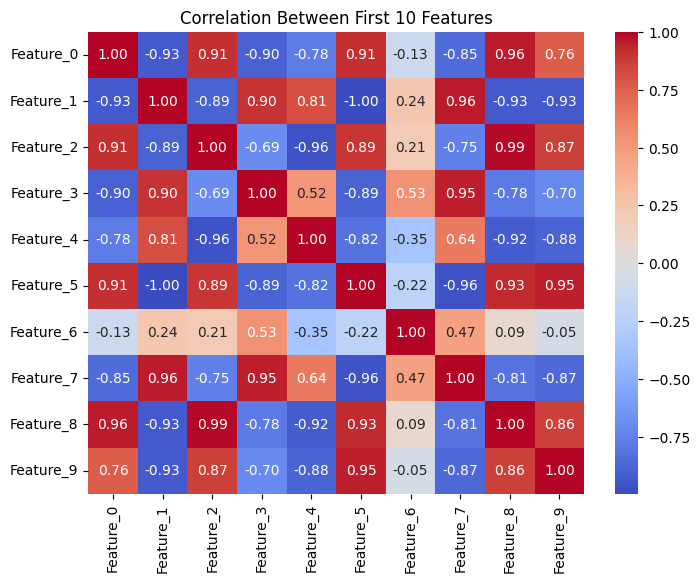

In [71]:
import pandas as pd

# Create a DataFrame for the first 10 features
feature_df = pd.DataFrame(X_train[:, :10], columns=[f'Feature_{i}' for i in range(10)])

# Compute correlation matrix
corr_matrix = feature_df.corr()

# Plot heatmap
plt.figure(figsize=(8, 6))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', fmt='.2f')
plt.title('Correlation Between First 10 Features')
plt.show()

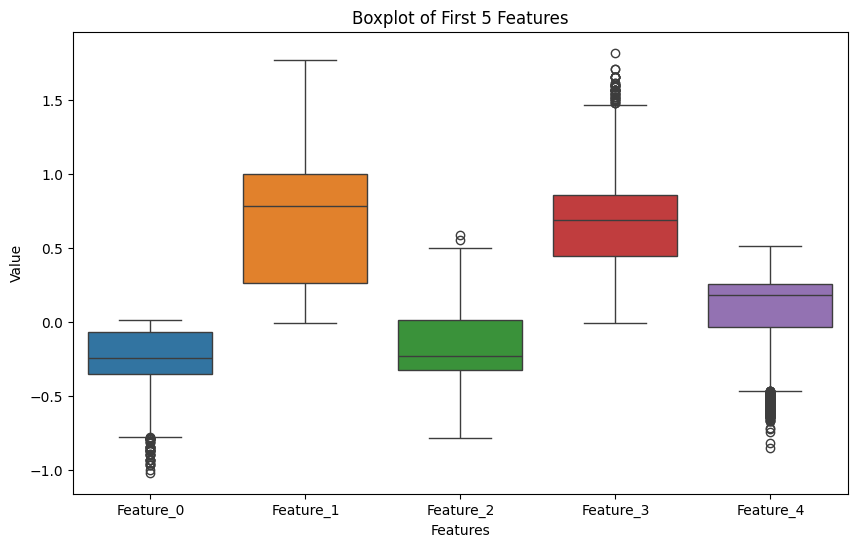

In [72]:
# Boxplot for the first 5 features
plt.figure(figsize=(10, 6))
sns.boxplot(data=pd.DataFrame(X_train[:, :5], columns=[f'Feature_{i}' for i in range(5)]))
plt.title('Boxplot of First 5 Features')
plt.xlabel('Features')
plt.ylabel('Value')
plt.show()

In [36]:
scaler = StandardScaler()
X_train = scaler.fit_transform(X_train)
X_val = scaler.transform(X_val)
X_test = scaler.transform(X_test)

# **Model**

## *Random Forest*

In [37]:
# Define parameter grid
rf_param_grid = {
    "n_estimators": randint(50, 300),
    "max_depth": [None, 10, 20, 30],
    "min_samples_split": randint(2, 10),
    "min_samples_leaf": randint(1, 4)
}

# Randomized Search
rf_random = RandomizedSearchCV(RandomForestClassifier(random_state=42), rf_param_grid, n_iter=20, cv=3, verbose=2, n_jobs=-1)
rf_random.fit(X_train, y_train)

# Best parameters
print("Best Hyperparameters for Random Forest:", rf_random.best_params_)

Fitting 3 folds for each of 20 candidates, totalling 60 fits
Best Hyperparameters for Random Forest: {'max_depth': 10, 'min_samples_leaf': 2, 'min_samples_split': 7, 'n_estimators': 271}


## *Decision Tree*

In [38]:
dt_param_grid = {
    "criterion": ["gini", "entropy"],
    "max_depth": [None, 10, 20, 30, 50],
    "min_samples_split": randint(2, 10),
    "min_samples_leaf": randint(1, 4)
}

dt_random = RandomizedSearchCV(DecisionTreeClassifier(random_state=42), dt_param_grid, n_iter=20, cv=3, verbose=2, n_jobs=-1)
dt_random.fit(X_train, y_train)

print("Best Hyperparameters for Decision Tree:", dt_random.best_params_)

Fitting 3 folds for each of 20 candidates, totalling 60 fits
Best Hyperparameters for Decision Tree: {'criterion': 'gini', 'max_depth': 30, 'min_samples_leaf': 2, 'min_samples_split': 2}


## *XGBoost*

In [39]:
xgb_param_grid = {
    "n_estimators": randint(50, 300),
    "learning_rate": [0.01, 0.1, 0.2, 0.3],
    "max_depth": randint(3, 10),
    "min_child_weight": randint(1, 6),
    "subsample": [0.6, 0.8, 1.0],
    "colsample_bytree": [0.6, 0.8, 1.0]
}

xgb_random = RandomizedSearchCV(XGBClassifier(use_label_encoder=False, eval_metric="mlogloss"), xgb_param_grid, n_iter=20, cv=3, verbose=2, n_jobs=-1)
xgb_random.fit(X_train, y_train)

print("Best Hyperparameters for XGBoost:", xgb_random.best_params_)

Fitting 3 folds for each of 20 candidates, totalling 60 fits


c:\Users\kazbe\AppData\Local\Programs\Python\Python311\Lib\site-packages\xgboost\core.py:158: UserWarning: [02:04:13] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-08cbc0333d8d4aae1-1\xgboost\xgboost-ci-windows\src\learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


Best Hyperparameters for XGBoost: {'colsample_bytree': 0.6, 'learning_rate': 0.01, 'max_depth': 7, 'min_child_weight': 1, 'n_estimators': 66, 'subsample': 1.0}


## *ANN*

In [40]:
def build_model(hp):
    model = Sequential()
    
    # Tunable number of layers
    for i in range(hp.Int('num_layers', 1, 3)):
        model.add(Dense(
            units=hp.Int(f'units_{i}', min_value=32, max_value=256, step=32),
            activation='relu'
        ))
        # Tunable dropout rate
        model.add(Dropout(
            rate=hp.Float(f'dropout_{i}', min_value=0.0, max_value=0.5, step=0.1)
        ))
    
    # Output layer
    model.add(Dense(1, activation='sigmoid'))
    
    # Tunable learning rate
    learning_rate = hp.Choice('learning_rate', values=[1e-2, 1e-3, 1e-4])
    
    # Compile the model
    model.compile(
        optimizer=keras.optimizers.Adam(learning_rate=learning_rate),
        loss='binary_crossentropy',
        metrics=['accuracy']
    )
    
    return model

tuner = RandomSearch(
    build_model,
    objective='val_accuracy',
    max_trials=10,  # Number of hyperparameter combinations to try
    executions_per_trial=2,  # Number of models to train per trial
    directory='ann_tuning',
    project_name='ann_hyperparameter_tuning'
)

tuner.search(
    X_train, y_train,
    epochs=10,
    batch_size=32,
    validation_data=(X_val, y_val)
)

# Get the best hyperparameters
best_hps = tuner.get_best_hyperparameters(num_trials=1)[0]

# Build the best model
best_model = tuner.hypermodel.build(best_hps)

# Train the best model
history = best_model.fit(
    X_train, y_train,
    epochs=50,  # Train for more epochs with the best hyperparameters
    batch_size=32,
    validation_data=(X_val, y_val)
)

# Evaluate the best model
loss, accuracy = best_model.evaluate(X_test, y_test)
print(f"Best Model Test Accuracy: {accuracy}")

print(f"""
Best Hyperparameters:
- Number of Layers: {best_hps.get('num_layers')}
- Units in Layer 1: {best_hps.get('units_0')}
- Units in Layer 2: {best_hps.get('units_1')}
- Dropout Rate: {best_hps.get('dropout_0')}
- Learning Rate: {best_hps.get('learning_rate')}
""")

Reloading Tuner from ann_tuning\ann_hyperparameter_tuning\tuner0.json
Epoch 1/50
248/248 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - accuracy: 0.3223 - loss: 0.1685 - val_accuracy: 0.3205 - val_loss: 0.1168
Epoch 2/50
248/248 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - accuracy: 0.3200 - loss: 0.0722 - val_accuracy: 0.3195 - val_loss: 0.0916
Epoch 3/50
248/248 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - accuracy: 0.3242 - loss: 0.3243 - val_accuracy: 0.3195 - val_loss: 0.0913
Epoch 4/50
248/248 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 0.3172 - loss: -0.5422 - val_accuracy: 0.3215 - val_loss: 0.1096
Epoch 5/50
248/248 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - accuracy: 0.3272 - loss: -0.7831 - val_accuracy: 0.3195 - val_loss: 0.0147
Epoch 6/50
248/248 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - accuracy: 0.3159 - loss: -1.1126 - val_accuracy: 0.3195 - val_loss: 0.1521
Epoch 7/50
248/248 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - accuracy: 0.3227 - loss: -3.1179 - val_accuracy: 0.3205 - val_loss: 0.1007
Epoch 8/50
248/248 ━━━━━━━━━━━

## *LSTM*

In [44]:
# Reshape input to (samples, timesteps, features)
X_train_reshaped = X_train.reshape((X_train.shape[0], 1, X_train.shape[1]))  # Add a "time step" dimension
X_test_reshaped = X_test.reshape((X_test.shape[0], 1, X_test.shape[1]))

# Define LSTM model with tunable parameters
def build_lstm_model(learning_rate=0.001, dropout_rate=0.3):
    model = Sequential([
        Bidirectional(LSTM(128, return_sequences=True, dropout=dropout_rate), input_shape=(1, X_train.shape[1])),
        Bidirectional(LSTM(64, dropout=dropout_rate)),
        Dense(32, activation="relu"),
        Dropout(dropout_rate),
        Dense(3, activation="softmax")
    ])
    optimizer = Adam(learning_rate=learning_rate)
    model.compile(optimizer=optimizer, loss="sparse_categorical_crossentropy", metrics=["accuracy"])
    return model

# Reduce LR if no improvement
lr_scheduler = ReduceLROnPlateau(monitor="val_loss", patience=2, factor=0.5, verbose=1)

lstm_model = build_lstm_model(learning_rate=0.0005, dropout_rate=0.4)
lstm_model.fit(X_train_reshaped, y_train, epochs=10, batch_size=32, validation_data=(X_test_reshaped, y_test), callbacks=[lr_scheduler])

# Evaluate
loss, accuracy = lstm_model.evaluate(X_test_reshaped, y_test)
print("Optimized LSTM Accuracy:", accuracy)

Epoch 1/10


c:\Users\kazbe\AppData\Local\Programs\Python\Python311\Lib\site-packages\keras\src\layers\rnn\bidirectional.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


248/248 ━━━━━━━━━━━━━━━━━━━━ 9s 9ms/step - accuracy: 0.3528 - loss: 1.0992 - val_accuracy: 0.3428 - val_loss: 1.0977 - learning_rate: 5.0000e-04
Epoch 2/10
248/248 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.3596 - loss: 1.0971 - val_accuracy: 0.3620 - val_loss: 1.0938 - learning_rate: 5.0000e-04
Epoch 3/10
248/248 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.3599 - loss: 1.0968 - val_accuracy: 0.3761 - val_loss: 1.0933 - learning_rate: 5.0000e-04
Epoch 4/10
248/248 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - accuracy: 0.3656 - loss: 1.0944 - val_accuracy: 0.3519 - val_loss: 1.0936 - learning_rate: 5.0000e-04
Epoch 5/10
244/248 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.3571 - loss: 1.0941
Epoch 5: ReduceLROnPlateau reducing learning rate to 0.0002500000118743628.
248/248 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.3570 - loss: 1.0941 - val_accuracy: 0.3357 - val_loss: 1.0957 - learning_rate: 5.0000e-04
Epoch 6/10
248/248 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - accuracy: 0.3734 - loss: 1

In [ ]:
# BERT Model
bert_tokenizer = BertTokenizer.from_pretrained('bert-base-uncased')
bert_model = TFBertForSequenceClassification.from_pretrained('bert-base-uncased')

c:\Users\kazbe\AppData\Local\Programs\Python\Python311\Lib\site-packages\transformers\tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(
All PyTorch model weights were used when initializing TFBertForSequenceClassification.

Some weights or buffers of the TF 2.0 model TFBertForSequenceClassification were not initialized from the PyTorch model and are newly initialized: ['classifier.weight', 'classifier.bias']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


# **Evaluation**

## *Random Forest*

Random Forest Evaluation:
Accuracy: 0.34643377001455605
Precision: 0.35028714860173193
Recall: 0.34643377001455605
F1-Score: 0.32923335922268593
              precision    recall  f1-score   support

           0       0.35      0.56      0.43       243
           1       0.39      0.21      0.27       217
           2       0.31      0.25      0.27       227

    accuracy                           0.35       687
   macro avg       0.35      0.34      0.33       687
weighted avg       0.35      0.35      0.33       687



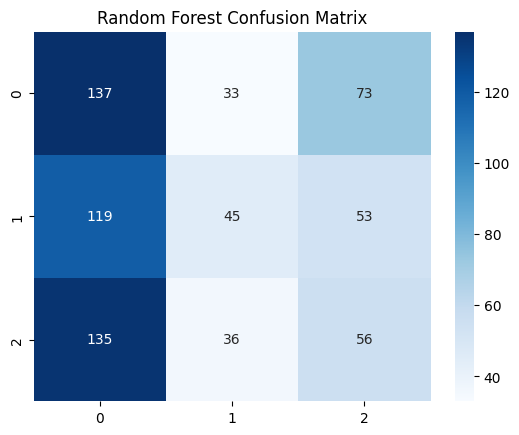

Random Forest AUC-ROC Score: 0.5008363866327675


In [ ]:
# Predictions
y_pred_rf = rf_random.best_estimator_.predict(X_test)
y_pred_proba_rf = rf_random.best_estimator_.predict_proba(X_test)

# Evaluation
print("Random Forest Evaluation:")
print(f"Accuracy: {accuracy_score(y_test, y_pred_rf)}")
print(f"Precision: {precision_score(y_test, y_pred_rf, average='weighted')}")
print(f"Recall: {recall_score(y_test, y_pred_rf, average='weighted')}")
print(f"F1-Score: {f1_score(y_test, y_pred_rf, average='weighted')}")
print(classification_report(y_test, y_pred_rf))

# Confusion Matrix
cm_rf = confusion_matrix(y_test, y_pred_rf)
sns.heatmap(cm_rf, annot=True, fmt='d', cmap='Blues')
plt.title("Random Forest Confusion Matrix")
plt.show()

# AUC-ROC Curve
roc_auc_rf = roc_auc_score(y_test, y_pred_proba_rf, multi_class='ovr')
print(f"Random Forest AUC-ROC Score: {roc_auc_rf}")

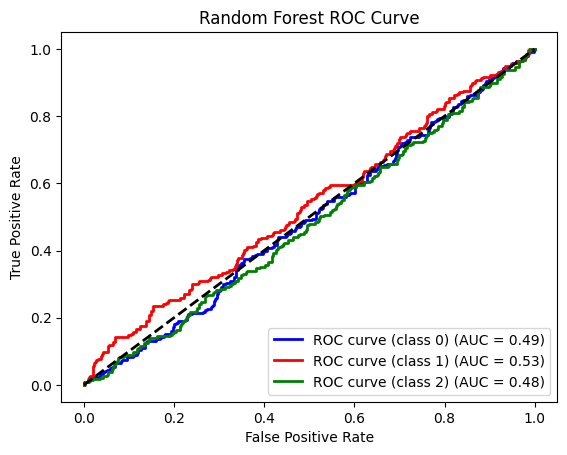

In [ ]:
from sklearn.metrics import roc_curve, auc
from sklearn.preprocessing import label_binarize
import matplotlib.pyplot as plt

# Binarize the labels for multi-class ROC
y_test_bin = label_binarize(y_test, classes=[0, 1, 2])
n_classes = y_test_bin.shape[1]

# Compute ROC curve and AUC for each class
fpr = dict()
tpr = dict()
roc_auc = dict()

for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_test_bin[:, i], y_pred_proba_rf[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])

# Plot ROC curve for each class
plt.figure()
colors = ['blue', 'red', 'green']
for i, color in zip(range(n_classes), colors):
    plt.plot(fpr[i], tpr[i], color=color, lw=2,
             label=f'ROC curve (class {i}) (AUC = {roc_auc[i]:.2f})')

plt.plot([0, 1], [0, 1], 'k--', lw=2)
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Random Forest ROC Curve')
plt.legend(loc="lower right")
plt.show()

## *Decision Tree*

Decision Tree Evaluation:
Accuracy: 0.35807860262008734
Precision: 0.3621412394143801
Recall: 0.35807860262008734
F1-Score: 0.35325278368697455
              precision    recall  f1-score   support

           0       0.37      0.46      0.41       243
           1       0.32      0.36      0.34       217
           2       0.39      0.25      0.31       227

    accuracy                           0.36       687
   macro avg       0.36      0.36      0.35       687
weighted avg       0.36      0.36      0.35       687



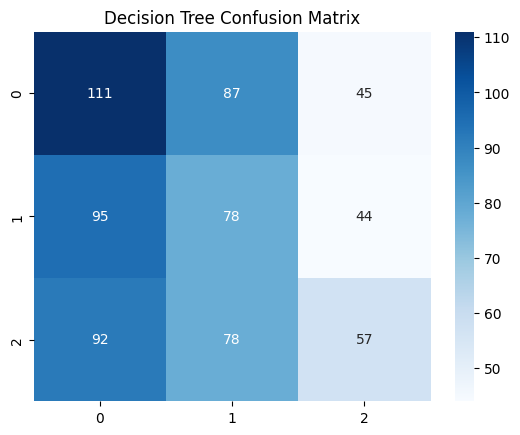

Decision Tree AUC-ROC Score: 0.524673598903296


In [ ]:
# Predictions
y_pred_dt = dt_random.best_estimator_.predict(X_test)
y_pred_proba_dt = dt_random.best_estimator_.predict_proba(X_test)

# Evaluation
print("Decision Tree Evaluation:")
print(f"Accuracy: {accuracy_score(y_test, y_pred_dt)}")
print(f"Precision: {precision_score(y_test, y_pred_dt, average='weighted')}")
print(f"Recall: {recall_score(y_test, y_pred_dt, average='weighted')}")
print(f"F1-Score: {f1_score(y_test, y_pred_dt, average='weighted')}")
print(classification_report(y_test, y_pred_dt))

# Confusion Matrix
cm_dt = confusion_matrix(y_test, y_pred_dt)
sns.heatmap(cm_dt, annot=True, fmt='d', cmap='Blues')
plt.title("Decision Tree Confusion Matrix")
plt.show()

# AUC-ROC Curve
roc_auc_dt = roc_auc_score(y_test, y_pred_proba_dt, multi_class='ovr')
print(f"Decision Tree AUC-ROC Score: {roc_auc_dt}")

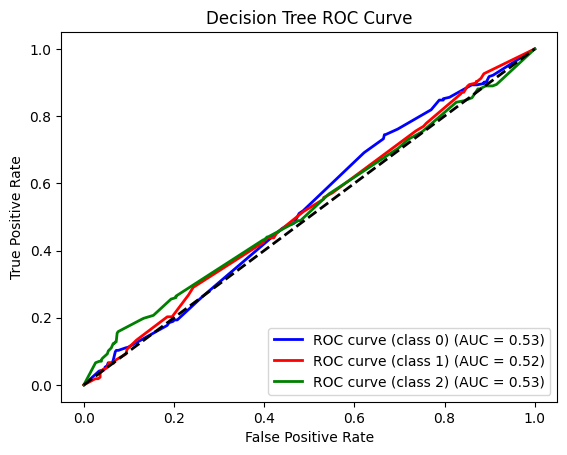

In [ ]:
# Compute ROC curve and AUC for each class
fpr = dict()
tpr = dict()
roc_auc = dict()

for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_test_bin[:, i], y_pred_proba_dt[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])

# Plot ROC curve for each class
plt.figure()
colors = ['blue', 'red', 'green']
for i, color in zip(range(n_classes), colors):
    plt.plot(fpr[i], tpr[i], color=color, lw=2,
             label=f'ROC curve (class {i}) (AUC = {roc_auc[i]:.2f})')

plt.plot([0, 1], [0, 1], 'k--', lw=2)
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Decision Tree ROC Curve')
plt.legend(loc="lower right")
plt.show()

## *XGBoost*

XGBoost Evaluation:
Accuracy: 0.35953420669577874
Precision: 0.35725279832968176
Recall: 0.35953420669577874
F1-Score: 0.34772217202739014
              precision    recall  f1-score   support

           0       0.37      0.54      0.44       243
           1       0.34      0.25      0.29       217
           2       0.37      0.26      0.31       227

    accuracy                           0.36       687
   macro avg       0.36      0.35      0.34       687
weighted avg       0.36      0.36      0.35       687



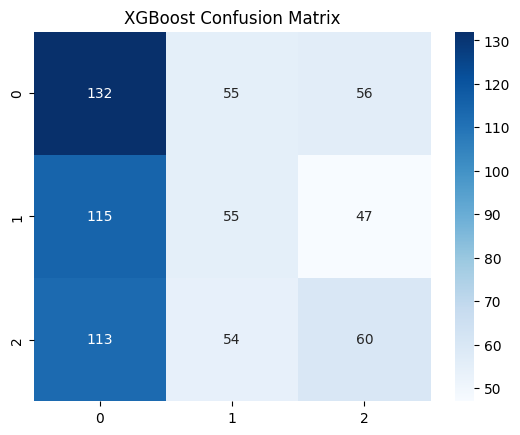

XGBoost AUC-ROC Score: 0.5140024578311163


In [ ]:
# Predictions
y_pred_xgb = xgb_random.best_estimator_.predict(X_test)
y_pred_proba_xgb = xgb_random.best_estimator_.predict_proba(X_test)

# Evaluation
print("XGBoost Evaluation:")
print(f"Accuracy: {accuracy_score(y_test, y_pred_xgb)}")
print(f"Precision: {precision_score(y_test, y_pred_xgb, average='weighted')}")
print(f"Recall: {recall_score(y_test, y_pred_xgb, average='weighted')}")
print(f"F1-Score: {f1_score(y_test, y_pred_xgb, average='weighted')}")
print(classification_report(y_test, y_pred_xgb))

# Confusion Matrix
cm_xgb = confusion_matrix(y_test, y_pred_xgb)
sns.heatmap(cm_xgb, annot=True, fmt='d', cmap='Blues')
plt.title("XGBoost Confusion Matrix")
plt.show()

# AUC-ROC Curve
roc_auc_xgb = roc_auc_score(y_test, y_pred_proba_xgb, multi_class='ovr')
print(f"XGBoost AUC-ROC Score: {roc_auc_xgb}")

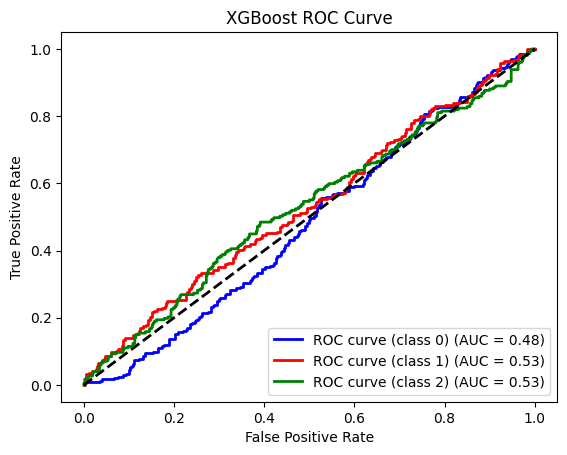

In [ ]:
# Compute ROC curve and AUC for each class
fpr = dict()
tpr = dict()
roc_auc = dict()

for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_test_bin[:, i], y_pred_proba_xgb[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])

# Plot ROC curve for each class
plt.figure()
colors = ['blue', 'red', 'green']
for i, color in zip(range(n_classes), colors):
    plt.plot(fpr[i], tpr[i], color=color, lw=2,
             label=f'ROC curve (class {i}) (AUC = {roc_auc[i]:.2f})')

plt.plot([0, 1], [0, 1], 'k--', lw=2)
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('XGBoost ROC Curve')
plt.legend(loc="lower right")
plt.show()

## *ANN*

22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
ANN Classification Report:
              precision    recall  f1-score   support

           0       0.00      0.00      0.00       243
           1       0.32      1.00      0.48       217
           2       0.00      0.00      0.00       227

    accuracy                           0.32       687
   macro avg       0.11      0.33      0.16       687
weighted avg       0.10      0.32      0.15       687



c:\Users\kazbe\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\metrics\_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\kazbe\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\metrics\_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\kazbe\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\metrics\_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, mo

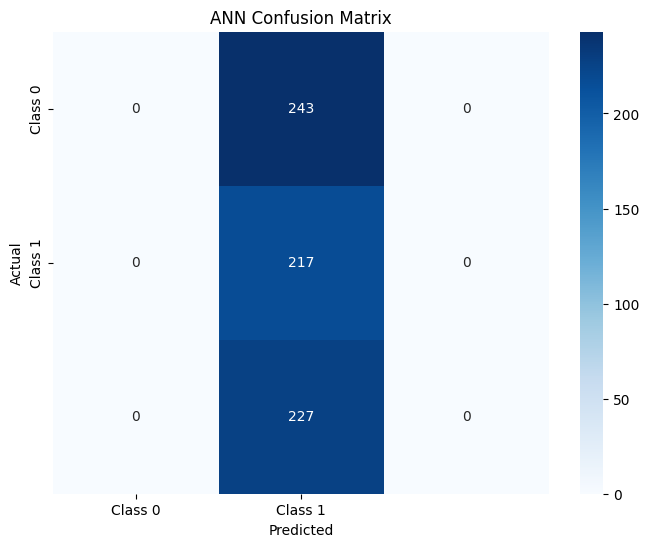

In [ ]:
# Predictions
y_pred_ann = best_model.predict(X_test)
y_pred_ann_classes = (y_pred_ann > 0.5).astype(int)  # Convert probabilities to binary predictions

from sklearn.metrics import classification_report

# Classification Report
print("ANN Classification Report:")
print(classification_report(y_test, y_pred_ann_classes))

from sklearn.metrics import confusion_matrix
import seaborn as sns
import matplotlib.pyplot as plt

# Confusion Matrix
cm_ann = confusion_matrix(y_test, y_pred_ann_classes)

# Plot
plt.figure(figsize=(8, 6))
sns.heatmap(cm_ann, annot=True, fmt='d', cmap='Blues', xticklabels=['Class 0', 'Class 1'], yticklabels=['Class 0', 'Class 1'])
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('ANN Confusion Matrix')
plt.show()

## *LSTM*

22/22 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step 
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
LSTM Evaluation:
Accuracy: 0.3522561863173217
Precision: 0.3727947361953912
Recall: 0.3522561863173217
F1-Score: 0.19728130727612775
              precision    recall  f1-score   support

           0       0.35      0.98      0.52       243
           1       0.50      0.01      0.02       217
           2       0.27      0.01      0.03       227

    accuracy                           0.35       687
   macro avg       0.38      0.33      0.19       687
weighted avg       0.37      0.35      0.20       687



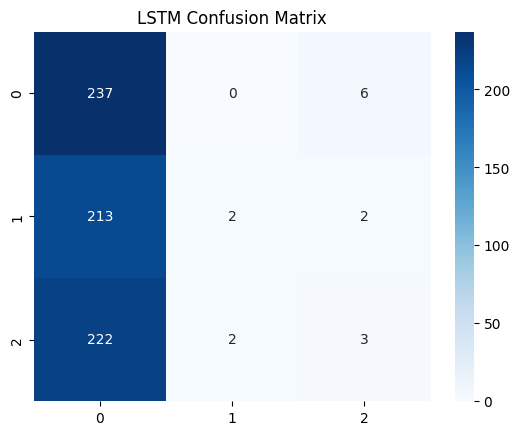

LSTM AUC-ROC Score: 0.5352057906588996


In [ ]:
# Predictions
y_pred_lstm = lstm_model.predict(X_test_reshaped).argmax(axis=1)
y_pred_proba_lstm = lstm_model.predict(X_test_reshaped)

# Evaluation
print("LSTM Evaluation:")
print(f"Accuracy: {accuracy_score(y_test, y_pred_lstm)}")
print(f"Precision: {precision_score(y_test, y_pred_lstm, average='weighted')}")
print(f"Recall: {recall_score(y_test, y_pred_lstm, average='weighted')}")
print(f"F1-Score: {f1_score(y_test, y_pred_lstm, average='weighted')}")
print(classification_report(y_test, y_pred_lstm))

# Confusion Matrix
cm_lstm = confusion_matrix(y_test, y_pred_lstm)
sns.heatmap(cm_lstm, annot=True, fmt='d', cmap='Blues')
plt.title("LSTM Confusion Matrix")
plt.show()

# AUC-ROC Curve
roc_auc_lstm = roc_auc_score(y_test, y_pred_proba_lstm, multi_class='ovr')
print(f"LSTM AUC-ROC Score: {roc_auc_lstm}")

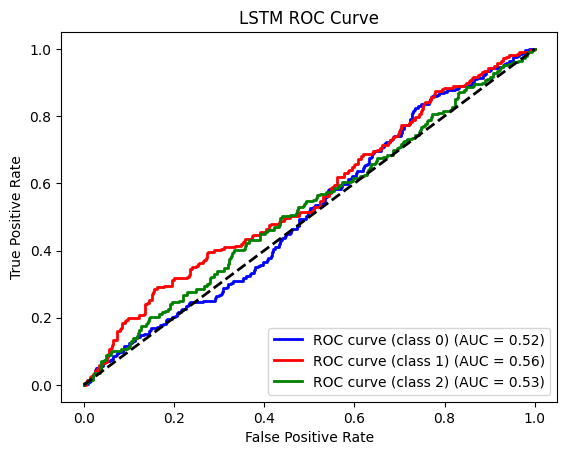

In [ ]:
# Compute ROC curve and AUC for each class
fpr = dict()
tpr = dict()
roc_auc = dict()

for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_test_bin[:, i], y_pred_proba_lstm[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])

# Plot ROC curve for each class
plt.figure()
colors = ['blue', 'red', 'green']
for i, color in zip(range(n_classes), colors):
    plt.plot(fpr[i], tpr[i], color=color, lw=2,
             label=f'ROC curve (class {i}) (AUC = {roc_auc[i]:.2f})')

plt.plot([0, 1], [0, 1], 'k--', lw=2)
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('LSTM ROC Curve')
plt.legend(loc="lower right")
plt.show()